<a href="https://colab.research.google.com/github/baovin/CV_VIN/blob/main/Background_subtraction_and_Kalman_filter_2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Phát hiện và bám vết chuyển động với phương pháp trừ nền và Kalman Filter

Trong bài tập này chúng ta sẽ thực hành phát hiện các đối tượng chuyển động (mà cụ thể trong bài thực hành này là người) sử dụng phương pháp trừ nền (Background subtraction) và bám vết các đối tượng này với bộ lọc Kalman (Kalman filter). Chú ý phải đưa cả các file .py và dữ liệu vào folder của bài thực hành

In [1]:
import numpy as np
import imutils
import cv2
import os
import matplotlib.pyplot as plt

In [2]:
!pip install gdown

In [3]:
!gdown 14yRIU6DbaH5TvfG47uhkallrQlDHYTXT

Downloading...
From (original): https://drive.google.com/uc?id=14yRIU6DbaH5TvfG47uhkallrQlDHYTXT
From (redirected): https://drive.google.com/uc?id=14yRIU6DbaH5TvfG47uhkallrQlDHYTXT&confirm=t&uuid=da63d691-b84f-445e-b018-ca570d28f5d1
To: /content/homework_CV.zip
100% 116M/116M [00:01<00:00, 62.8MB/s]


## Phần 1: Phát hiện chuyển động

Đầu tiên ta sẽ thực hành phát hiện chuyển động với mô hình trừ nền Gaussian Mixture Model. Mô hình này ta được cài đặt sẵn trong thư viện OpenCV. Quan sát file source code part1_1.py, trong file này ta sẽ đọc video dữ liệu, sau đó sử dụng Gaussian Mixture Model để phát hiện đối tượng chuyển động trong video. Hãy quan sát kết quả sau:

*Chú ý đưa file gmm.png vào

In [5]:
!unzip homework_CV.zip

Archive:  homework_CV.zip
   creating: homework_CV/
  inflating: __MACOSX/._homework_CV  
  inflating: homework_CV/part1_2.py  
  inflating: __MACOSX/homework_CV/._part1_2.py  
  inflating: homework_CV/.DS_Store   
  inflating: __MACOSX/homework_CV/._.DS_Store  
  inflating: homework_CV/gmm.png     
  inflating: __MACOSX/homework_CV/._gmm.png  
  inflating: homework_CV/tracker.py  
  inflating: __MACOSX/homework_CV/._tracker.py  
  inflating: homework_CV/Background_subtraction_and_Kalman_filter_2022.ipynb  
  inflating: __MACOSX/homework_CV/._Background_subtraction_and_Kalman_filter_2022.ipynb  
  inflating: homework_CV/kalman_filter.py  
  inflating: __MACOSX/homework_CV/._kalman_filter.py  
  inflating: homework_CV/test.avi    
  inflating: __MACOSX/homework_CV/._test.avi  
   creating: homework_CV/data/
  inflating: __MACOSX/homework_CV/._data  
  inflating: homework_CV/part2.py    
  inflating: __MACOSX/homework_CV/._part2.py  
  inflating: homework_CV/part1_1.py  
  inflating: __M

In [6]:
cd /content/homework_CV/

/content/homework_CV


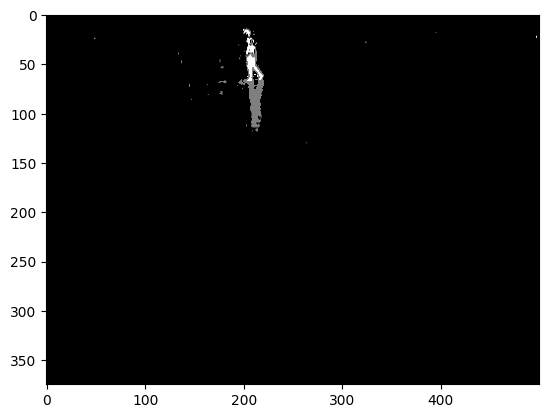

In [14]:
img = cv2.imread('gmm.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY);
plt.imshow(img, cmap='gray')
plt.show()

Trong kết quả trên và cả trong thực tế, khi áp dụng GMM ta hay thu được kết quả có nhiễu hạt, để khử những nhiễu hạt này ta có thể sử dụng Median filter đã được cài đặt sẵn trong OpenCV: (Sử dụng cv2.medianBlur)

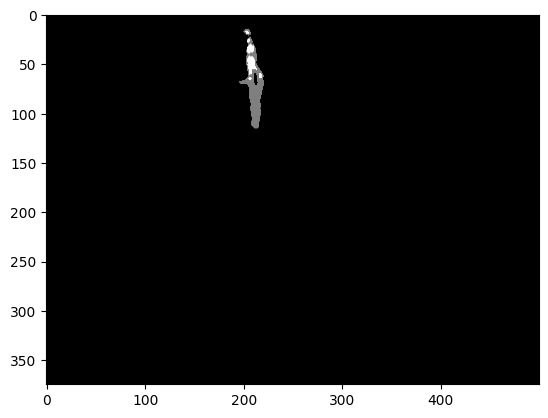

In [15]:
blur = cv2.medianBlur(img, 5)
plt.imshow(blur, cmap='gray')

Tiếp theo, ta sử dụng phép biến đổi dilate để nối các block cùng màu lại với nhau: (Sử dụng cv2.dilate)

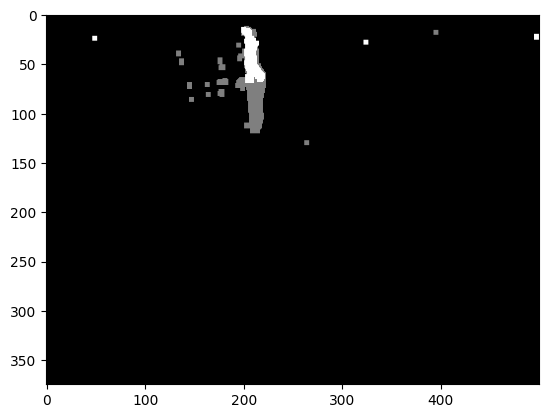

In [16]:
kernel = np.ones((5, 5), np.uint8)
dilate = cv2.dilate(img, kernel)
plt.imshow(dilate, cmap='gray')

Trong mô hình GMM được cài đặt trong OpenCV, đối tượng chuyển động sẽ được biểu diễn bằng các pixel trắng, bóng (shadow) của đối tượng được biểu diễn bằng các pixel màu xám hơn. Ta sẽ thực hiện một bước biến đổi đơn giản để loại bỏ bóng:

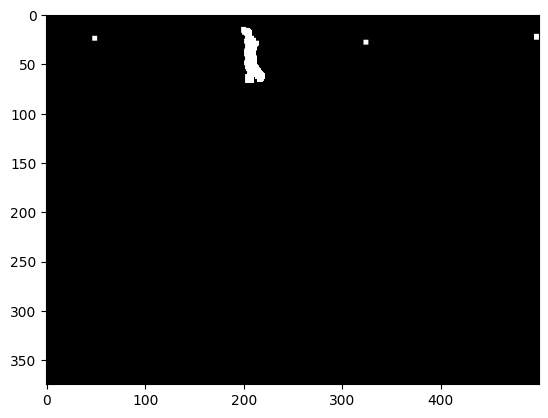

In [17]:
_, dilate = cv2.threshold(dilate, 127, 255, cv2.THRESH_BINARY)
plt.imshow(dilate, cmap='gray')
plt.show()

Tiếp theo, dùng hàm findContours của OpenCV để tìm các vật thể trong khung hình:

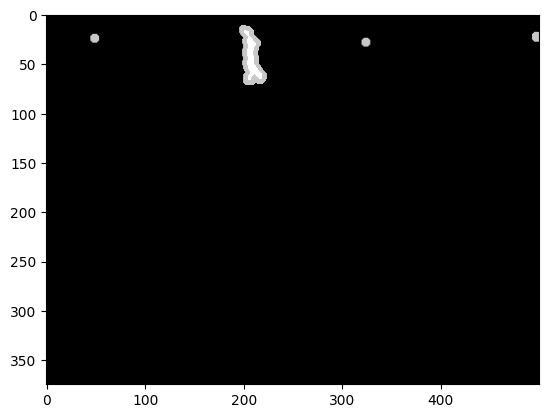

In [18]:
contours, hierarchy = cv2.findContours(dilate, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts_image = cv2.drawContours(dilate, contours, -1, (200), 3)
plt.imshow(cnts_image, cmap='gray')
plt.show()

Cuối cùng, ta sẽ vẽ một bounding box hình chữ nhật để bao quanh vật thể, OpenCV hỗ trợ hàm boundingRect để làm việc này, kết quả thu được như sau:

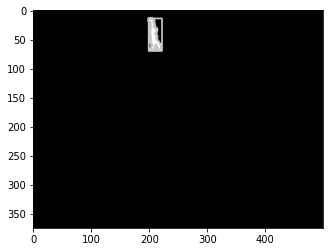

In [ ]:
(x, y, w, h) = cv2.boundingRect(contours[0])

cv2.rectangle(cnts_image, (x, y), (x + w, y + h), (200), 2)
plt.imshow(cnts_image, cmap='gray')
plt.show()

Ngoài ra, trong nhiều trường hợp, ta có thể tìm thấy nhiều vật thể khác nhau bằng phương pháp này. Lúc đó ta cần có những biện pháp khác nhau để loại bỏ những vật thể không mong muốn. Trong bài toán ta đang khảo sát, mỗi khung hình ta chỉ giữ lại vật thể mà bounding box của nó có diện tích lớn nhất, và diện tích này phải lớn hơn một ngưỡng cho trước nào đó. Tổng kết lại tất cả các vấn đề trên, ta thu được đoạn mã nguồn để phát hiện đối tượng: part1_2.py

## Phần 2: Bám vết vật thể với Kalman filter

Tiếp theo, ta sẽ bám vết vật thể với bộ lọc Kalman. OpenCV cũng đã hỗ trợ bộ lọc này, ta cần hiểu rõ các tham số của bộ lọc. Hàm sau đây hỗ trợ ta khởi tạo một đối tượng Kalman filter:

Do ta cần thao tác với video nên phần này chúng ta sẽ thực hành trực tiếp trên file mã nguồn. Hãy cùng quan sát và hoàn chỉnh file part2.py

In [19]:
import imutils
import cv2
import numpy as np


# Create kalman filter object
def create_kalman():
    dt = 0.2
    kalman = cv2.KalmanFilter(4, 2, 0)
    kalman.transitionMatrix = np.array(
        [[1., 0., dt, 0.], [0., 1., 0., dt], [0., 0., 1., 0.], [0., 0., 0., 1.]], dtype=np.float32)
    kalman.measurementMatrix = np.array([[1, 0, 0, 0], [0, 1, 0, 0]], dtype=np.float32)
    kalman.processNoiseCov = 0.5 * np.array([[dt ** 4.0 / 4.0, 0., dt ** 3.0 / 2.0, 0.],
                                             [0., dt ** 4.0 / 4.0, 0., dt ** 3.0 / 2.0],
                                             [dt ** 3.0 / 2.0, 0., dt ** 2.0, 0.],
                                             [0., dt ** 3.0 / 2.0, 0., dt ** 2.0]], dtype=np.float32)
    kalman.measurementNoiseCov = 1e-1 * np.eye(2, dtype=np.float32)
    kalman.errorCovPost = 1e-1 * np.eye(4, dtype=np.float32)
    return kalman

load file 'test.avi'  và khởi tạo

In [20]:

video_path = 'test.avi'

# Initialize video reader object
vs = cv2.VideoCapture(video_path)

# Initialize GMM object
fgbg = cv2.createBackgroundSubtractorMOG2(varThreshold=16, detectShadows=True)

# Kalman Filter
kalman = create_kalman()

In [21]:
# List detection by background subtraction
list_detection = []

# List estimation by kalman filter
list_predict = []

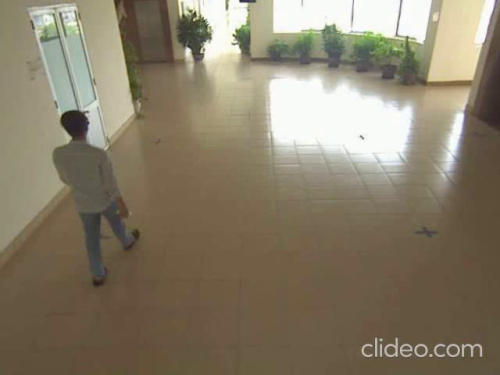

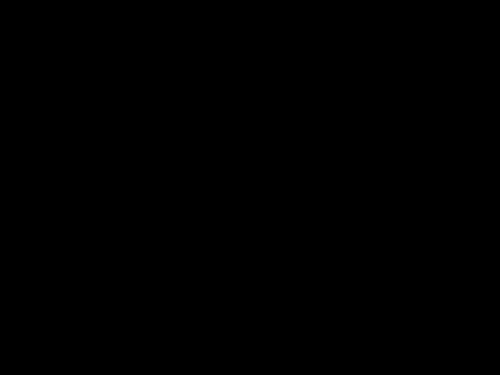

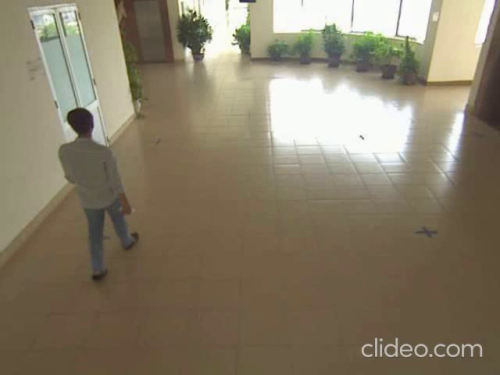

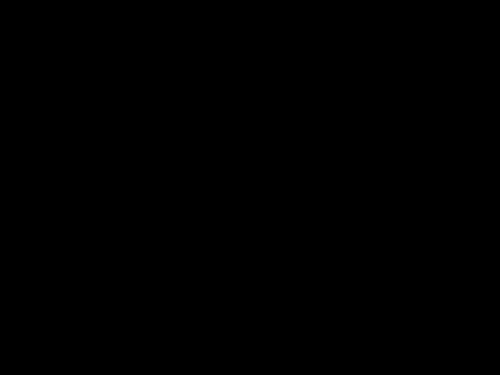

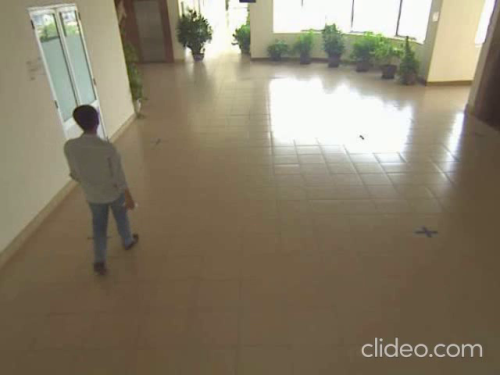

...

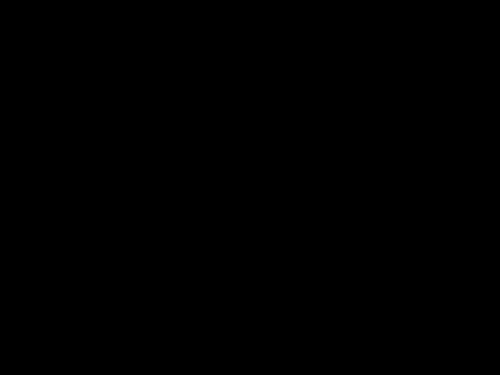

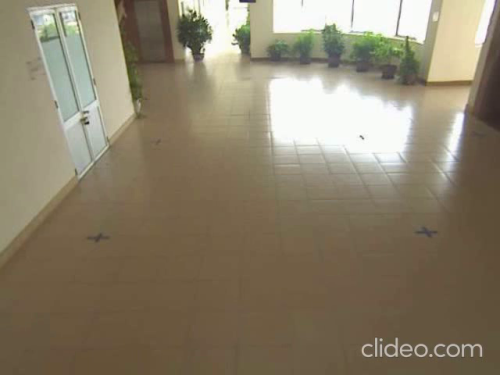

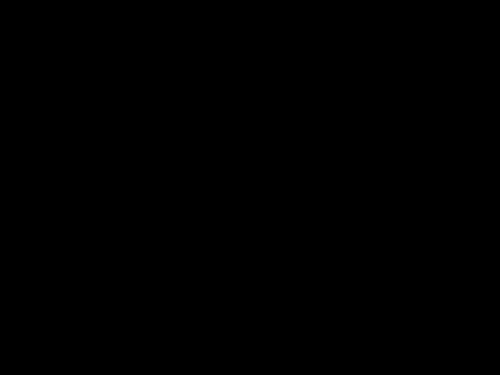

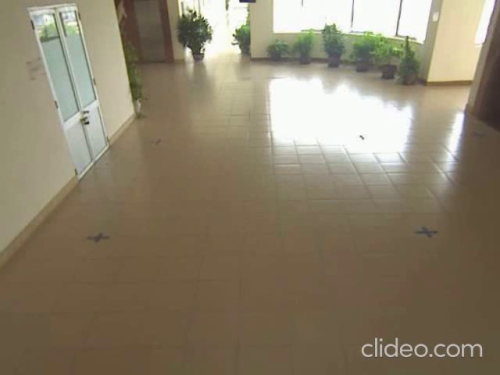

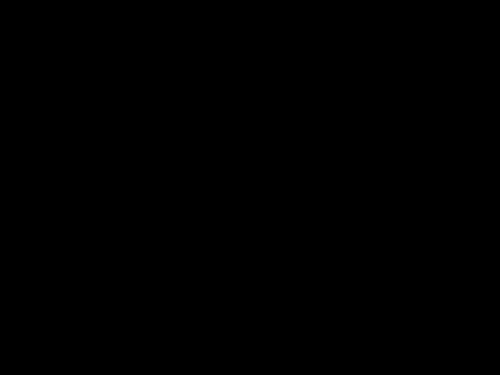

In [22]:
from google.colab.patches import cv2_imshow
# Process
while True:
    # Read video
    _, frame = vs.read()

    # If end of video, break
    if frame is None:
        break

    # resize the frame, easy to display
    frame = imutils.resize(frame, width=500)

    # Apply GMM model to frame
    thresh = fgbg.apply(frame)

    # Remove noise
    thresh = cv2.medianBlur(thresh, 5)

    # Dilate
    thresh = cv2.dilate(thresh, None, iterations=2)

    # Threshold image
    _, thresh = cv2.threshold(thresh, 127, 255, cv2.THRESH_BINARY)

    # Find contours
    cnts, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Find contours with maximum area
    maxArea = 0
    maxContour = None
    for c in cnts:
        if (cv2.contourArea(c) > maxArea) and (cv2.contourArea(c) >= 500):
            maxArea = cv2.contourArea(c)
            maxContour = c

    if maxContour is None:
        list_detection = []

        # New
        list_predict = []

    else:
        # Draw result
        (x, y, w, h) = cv2.boundingRect(maxContour)
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
        dx = int(x + w / 2)
        dy = int(y + h / 2)
        list_detection.append((dx, dy))

        # Init statePre
        if len(list_detection) == 1:
            kalman = create_kalman()
            kalman.statePre = np.array([[dx], [dy], [0.], [0.]], dtype=np.float32)

        # Kalman correct
        kalman.correct(np.array([[dx], [dy]], dtype=np.float32))

        # Kalman predict
        ######################
        estimate = kalman.predict()
        ######################
        list_predict.append((estimate[0, 0], estimate[1, 0]))

        if len(list_detection) > 1:
            for i in range(len(list_detection) - 1):
                x, y = list_detection[i]
                u, v = list_detection[i + 1]
                cv2.line(frame, (x, y), (u, v), (0, 0, 255))

            # Draw tracker
            for i in range(len(list_detection) - 1):
                x, y = list_predict[i]
                u, v = list_predict[i + 1]
                cv2.line(frame, (int(x), int(y)), (int(u), int(v)), (255, 0, 0))

    # Display result
    cv2_imshow(frame)
    cv2_imshow(thresh)



cv2.destroyAllWindows()